## Tic-Tac-Toe Agent
​
In this notebook, you will learn to build an RL agent (using Q-learning) that learns to play Numerical Tic-Tac-Toe with odd numbers. The environment is playing randomly with the agent, i.e. its strategy is to put an even number randomly in an empty cell. The following is the layout of the notebook:
        - Defining epsilon-greedy strategy
        - Tracking state-action pairs for convergence
        - Define hyperparameters for the Q-learning algorithm
        - Generating episode and applying Q-update equation
        - Checking convergence in Q-values

#### Importing libraries
Write the code to import Tic-Tac-Toe class from the environment file

In [1]:
# from <TC_Env> import <TicTacToe> - import your class from environment file
from TCGame_Env1 import TicTacToe
import collections
import numpy as np
import random
import pickle
import time
from matplotlib import pyplot as plt

In [2]:
# Function to convert state array into a string to store it as keys in the dictionary
# states in Q-dictionary will be of form: x-4-5-3-8-x-x-x-x
#   x | 4 | 5
#   ----------
#   3 | 8 | x
#   ----------
#   x | x | x

def Q_state(state):

    return ('-'.join(str(e) for e in state)).replace('nan','x')

In [3]:
# Defining a function which will return valid (all possible actions) actions corresponding to a state
# Important to avoid errors during deployment.

def valid_actions(state):

    valid_Actions = []
    
    valid_Actions = [i for i in env.action_space(state)[0]] ###### -------please call your environment as env
    return valid_Actions

In [4]:
# Defining a function which will add new Q-values to the Q-dictionary. 
def add_to_dict(state):
    state1 = Q_state(state)
    
    valid_act = valid_actions(state)
    if state1 not in Q_dict.keys():
        for action in valid_act:
            Q_dict[state1][action]=0

#### Epsilon-greedy strategy - Write your code here

(you can build your epsilon-decay function similar to the one given at the end of the notebook)

In [5]:
# Defining epsilon-greedy policy. You can choose any function epsilon-decay strategy

def epsilon_greedy(state, time):
    epsilon = MIN_EPSILON + (MAX_EPSILON - MIN_EPSILON) * np.exp(-0.0000001*time)
    ee = np.random.random()
    if ee > epsilon:
        # q value max value
        state_next = Q_state(state)
        action = max(Q_dict[state_next],key=Q_dict[state_next].get)
    else:
        # random action 
        agent_actions, env_actions = env.action_space(state)
        action = random.choice(list(agent_actions))
    return action




#### Tracking the state-action pairs for checking convergence - write your code here

In [6]:
# Initialise Q_dictionary as 'Q_dict' and States_tracked as 'States_track' (for convergence)
Q_dict = collections.defaultdict(dict)
States_track = collections.defaultdict(dict)

In [8]:
# Initialising states to be tracked
def initialise_tracking_states():
    sqv = [('x-x-x-x-x-x-x-x-x',(7,5)),('x-x-x-x-x-x-x-x-x',(2,9)),
                       ('x-2-x-x-1-x-x-x-x',(6,5)),('4-x-x-7-x-x-x-x-x',(1,1))]    
    for q_values in sqv:
        state = q_values[0]
        action = q_values[1]
        States_track[state][action] = []

In [9]:
#Defining a function to save the Q-dictionary as a pickle file

def save_obj(obj, name ):
    with open(name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

In [10]:
def save_tracking_states():
    for state in States_track.keys():
        for action in States_track[state].keys():
            if state in Q_dict and action in Q_dict[state]:
                States_track[state][action].append(Q_dict[state][action])

In [11]:
initialise_tracking_states()

#### Define hyperparameters  ---write your code here

In [12]:
EPISODES = 200000
LR = 0.01  
GAMMA = 0.91
MAX_EPSILON = 1.0
MIN_EPSILON = 0.001
threshold = 2000      
policy_threshold = 30000

### Q-update loop ---write your code here

In [17]:
start_time = time.time()

for episode in range(EPISODES):
    env = TicTacToe()
    
    curr_state = env.state
    isTerminated = False
    
    add_to_dict(curr_state)
    total_reward = 0

    while not isTerminated:
        current_state_ele = Q_state(curr_state)
        curr_action = epsilon_greedy(curr_state, episode)
        next_state, reward, isTerminated = env.step(curr_state, curr_action)

        next_state_ele = Q_state(next_state)
        add_to_dict(next_state)

        if isTerminated:
            Q_dict[current_state_ele][curr_action] += LR * (
                (reward - Q_dict[current_state_ele][curr_action]))
        else:
            max_next = max(Q_dict[next_state_ele],
                           key=Q_dict[next_state_ele].get)
            Q_dict[current_state_ele][curr_action] += LR * (
                (reward + (GAMMA * (Q_dict[next_state_ele][max_next]))) -
                Q_dict[current_state_ele][curr_action])

        curr_state = next_state
        total_reward += reward
        print("reward ",total_reward)

    # Tracking the Q-Values here
    
    if (episode == threshold-1):        #at the 1999th episode
        initialise_tracking_states()

    if ((episode+1) % threshold) == 0:   #every 2000th episode
        save_tracking_states()
        save_obj(States_track,'States_tracked')

    # Saving the Policy here
    
    if ((episode+1)% policy_threshold ) == 0:  #every 30000th episodes, the Q-dict will be saved
        save_obj(Q_dict,'Policy')

elapsed_time = time.time() - start_time
save_obj(States_track, 'States_tracked')
save_obj(Q_dict, 'Policy')
print(elapsed_time)

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
rew

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
re

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -13
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
rew

reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
rew

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
re

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  8
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -1

reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward 

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  

reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward 

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward 

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
r

reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward 

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
re

reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
re

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
rew

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
r

reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -12
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
re

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward 

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
rew

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  7
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
rewar

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  

reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward 

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
re

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
rew

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward 

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3


reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
r

reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
rew

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward 

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1

reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  

reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
re

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
re

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward 

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2


reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4


reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward 

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4


reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1


reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -11
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -

reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -12
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  8
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1

reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
r

reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  6
reward  -1
reward  -2
reward  -3
reward  -13
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4

reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  7
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3
reward  -4
reward  -4
reward  -1
reward  -2
reward  -3


#### Check the Q-dictionary

In [18]:
Q_dict

defaultdict(dict,
            {'x-x-x-x-x-x-x-x-x': {(0, 1): -1.0195210168297804,
              (0, 3): -1.0164388011989245,
              (0, 5): -1.0164597002063263,
              (0, 7): -1.0181228555892436,
              (0, 9): -1.0178940531304375,
              (1, 1): -1.0185508514492594,
              (1, 3): -1.0180406750456092,
              (1, 5): -1.0164235239210264,
              (1, 7): -1.0195950733698518,
              (1, 9): -1.0182306762498128,
              (2, 1): -1.0176225192745707,
              (2, 3): -1.0191816954023654,
              (2, 5): -1.0164768287956023,
              (2, 7): -1.0197754746478973,
              (2, 9): -1.0169702307820805,
              (3, 1): -1.0178985098755584,
              (3, 3): -1.0171984520233965,
              (3, 5): -1.017299657010748,
              (3, 7): -1.0178293536427696,
              (3, 9): -1.0174221628121343,
              (4, 1): -1.0192214057542102,
              (4, 3): -1.0180633733860545,
              (4

In [19]:
len(Q_dict)

583121

In [20]:
# try checking for one of the states - that which action your agent thinks is the best  -----This will not be evaluated
max(Q_dict['x-x-x-x-x-x-x-x-x'],key=Q_dict['x-x-x-x-x-x-x-x-x'].get)

(8, 5)

#### Check the states tracked for Q-values convergence
(non-evaluative)

In [0]:
# Write the code for plotting the graphs for state-action pairs tracked

<function matplotlib.pyplot.show(close=None, block=None)>

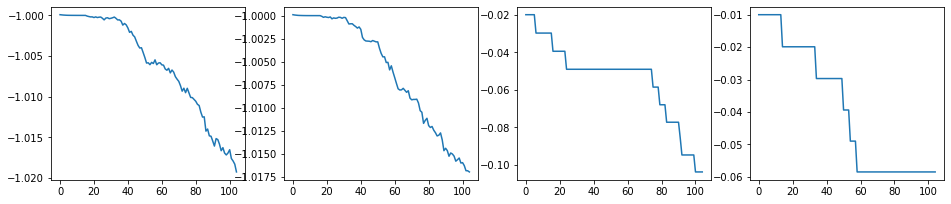

In [22]:
plt.figure(0, figsize=(16,7))

x_axis = np.asarray(range(0, len(States_track['x-x-x-x-x-x-x-x-x'][(7,5)])))
plt.subplot(241)
plt.plot(x_axis,np.asarray(States_track['x-x-x-x-x-x-x-x-x'][(7,5)]))
plt.show

x_axis = np.asarray(range(0, len(States_track['x-x-x-x-x-x-x-x-x'][(2,9)])))
plt.subplot(242)
plt.plot(x_axis,np.asarray(States_track['x-x-x-x-x-x-x-x-x'][(2,9)]))
plt.show

x_axis = np.asarray(range(0, len(States_track['x-2-x-x-1-x-x-x-x'][(6,5)])))
plt.subplot(243)
plt.plot(x_axis,np.asarray(States_track['x-2-x-x-1-x-x-x-x'][(6,5)]))
plt.show


x_axis = np.asarray(range(0, len(States_track['4-x-x-7-x-x-x-x-x'][(1,1)])))
plt.subplot(244)
plt.plot(x_axis,np.asarray(States_track['4-x-x-7-x-x-x-x-x'][(1,1)]))
plt.show

### Epsilon - decay check

In [23]:
max_epsilon = 1.0
min_epsilon = 0.001
time = np.arange(0,5000000)
epsilon = []
for i in range(0,5000000):
    epsilon.append(min_epsilon + (max_epsilon - min_epsilon) * np.exp(-0.000001*i))

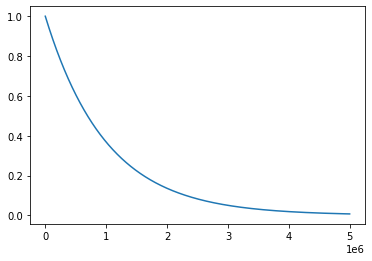

In [24]:
plt.plot(time, epsilon)
plt.show()